In [1]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import anndata 
import seaborn as sns
from scipy.stats import zscore
from scipy import sparse 
import itertools

import matplotlib.pyplot as plt
import collections
from sklearn.cluster import KMeans
from sklearn import metrics

from sklearn.decomposition import PCA
from umap import UMAP

from matplotlib.colors import LinearSegmentedColormap

from scroutines.config_plots import *
from scroutines import powerplots # .config_plots import *
from scroutines import pnmf
from scroutines import basicu


/home/qlyu/mambaforge/envs/bbbroutine/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
outdir     = "/scr/qlyu/projects/v1/results"
outdir_fig = "/scr/qlyu/projects/v1/figures"

In [3]:
adata_raw = anndata.read("../../data/cheng21_cell_scrna/reorganized/all_IT.h5ad")
adata_raw = adata_raw[adata_raw.obs['cond']=='P28NR']
counts = adata_raw.X
allgenes = adata_raw.var.index.values
adata_raw

View of AnnData object with n_obs × n_vars = 11061 × 53801
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond'

In [4]:
conds = adata_raw.obs['cond'].values
types = adata_raw.obs['Type'].values
samps = adata_raw.obs['sample'].values

rename_dict = {
    "L2/3_A": "L2/3_A",
    "L2/3_B": "L2/3_B",
    "L2/3_C": "L2/3_C",
    
    "L2/3_1": "L2/3_A",
    "L2/3_2": "L2/3_B",
    "L2/3_3": "L2/3_C",
    
    "L2/3_AB": "L2/3_A",
    "L2/3_BC": "L2/3_C",
}

def rename(x):
    """
    """
    if x in rename_dict.keys():
        return rename_dict[x]
    else:
        return x
    
adata_raw.obs['easitype'] = adata_raw.obs['Type'].apply(rename)

/tmp/ipykernel_2017199/2186893235.py:26: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_raw.obs['easitype'] = adata_raw.obs['Type'].apply(rename)


In [5]:
# use those 286 genes
# df = pd.read_csv("../../data/cheng21_cell_scrna/res/candidate_genes_vincent_0503_v2.csv")
df = pd.read_csv("../../data/cheng21_cell_scrna/res/L23-ABC-genes-n288-n286unq-annot.csv")
genes_l23 = df['gene'].values
# genes_sel = adata_raw.var.index.values
# genes_grp = df['P17on'].astype(str).values
# assert len(genes_sel) == len(np.unique(genes_sel))

# Use P28 ordering
f = '../../results/gene_ptime_P28_L23_Mar27.tsv'
gpt = pd.read_csv(f)
gpt = gpt['gene_ptime'].values
gptidx = np.argsort(gpt)

In [6]:
# genes_l23

In [7]:
# filter genes
cond = np.ravel((adata_raw.X>0).sum(axis=0)) > 10 # expressed in more than 10 cells
adata_sub = adata_raw[:,cond]

# counts
x = adata_sub.X
cov = adata_sub.obs['n_counts'].values
genes = adata_sub.var.index.values

# CP10k
xn = (sparse.diags(1/cov).dot(x))*1e4

# log10(CP10k+1)
xln = xn.copy()
xln.data = np.log10(xln.data+1)

adata_sub.layers['norm'] = xn
adata_sub.layers['lognorm'] = xln

In [8]:
# select HVGs with mean and var
nbin = 20
qth = 0.3

# min
gm = np.ravel(xn.mean(axis=0))

# var
tmp = xn.copy()
tmp.data = np.power(tmp.data, 2)
gv = np.ravel(tmp.mean(axis=0))-gm**2

# cut 
lbl = pd.qcut(gm, nbin, labels=np.arange(nbin))
gres = pd.DataFrame()
gres['name'] = genes
gres['lbl'] = lbl
gres['mean'] = gm
gres['var'] = gv
gres['ratio']= gv/gm

# gres = gres[gres['lbl'] != nbin-1] # remove largest bin from consideration

# select
gres_sel = gres.groupby('lbl')['ratio'].nlargest(int(qth*(len(gm)/nbin))) #.reset_index()
gsel_idx = np.sort(gres_sel.index.get_level_values(1).values)

assert np.all(gsel_idx != -1)

In [9]:
l23_gidx = basicu.get_index_from_array(genes, genes_l23)
assert np.all(l23_gidx != -1)

/tmp/ipykernel_2017199/1746754850.py:19: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(gm[l23_gidx], (gv/gm)[l23_gidx], s=10, edgecolor='none', cmap='rocket_r')


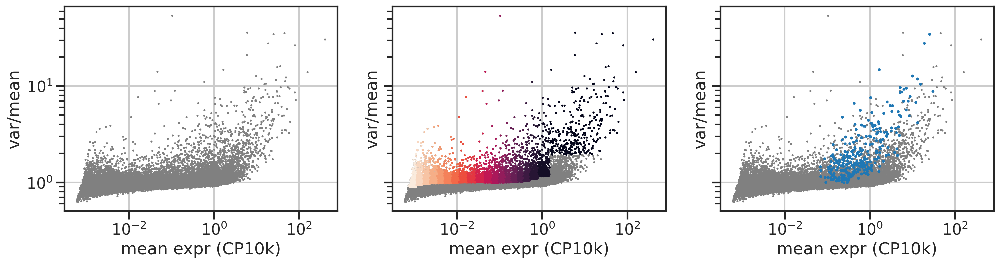

In [10]:
fig, axs = plt.subplots(1,3, figsize=(6*3,4), sharex=True, sharey=True)
ax = axs[0]
ax.scatter(gm, gv/gm, s=5, edgecolor='none', color='gray')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('mean expr (CP10k)')
ax.set_ylabel('var/mean')

ax = axs[1]
ax.scatter(gm, gv/gm, s=5, edgecolor='none', color='gray')
ax.scatter(gm[gsel_idx], (gv/gm)[gsel_idx], c=lbl[gsel_idx], s=5, edgecolor='none', cmap='rocket_r')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('mean expr (CP10k)')
ax.set_ylabel('var/mean')

ax = axs[2]
ax.scatter(gm, gv/gm, s=5, edgecolor='none', color='gray')
ax.scatter(gm[l23_gidx], (gv/gm)[l23_gidx], s=10, edgecolor='none', cmap='rocket_r')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('mean expr (CP10k)')
ax.set_ylabel('var/mean')
plt.show()

In [11]:
[genes[i] for i in l23_gidx if i not in gsel_idx]

['Runx1t1',
 'Foxp1',
 'Focad',
 'Clcn2',
 'Elavl2',
 'Cntn2',
 'Cntnap1',
 'Sel1l3',
 'Osbpl3',
 'Igsf9b',
 'Mkx']

In [12]:
np.intersect1d(l23_gidx, gsel_idx).shape, l23_gidx.shape

((275,), (286,))

In [13]:
gres_sel

lbl       
0    9143     1.956999
     9203     1.713492
     5768     1.683505
     21609    1.598302
     8370     1.577495
                ...   
19   17354    1.943190
     1889     1.941763
     21763    1.940247
     21333    1.934417
     6352     1.933979
Name: ratio, Length: 6600, dtype: float32

In [14]:
adata_sel = adata_sub[:,gsel_idx]
adata_sel

View of AnnData object with n_obs × n_vars = 11061 × 6600
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond', 'easitype'
    layers: 'norm', 'lognorm'

In [15]:
genes_sel = adata_sel.var.index.values
genes_sel

array(['Xkr4', 'Gm1992', 'Gm6123', ..., 'Tmlhe', 'AC149090.1',
       'CAAA01118383.1'], dtype=object)

In [16]:
lognorm = np.array(adata_sel.layers['lognorm'].todense())
zlognorm = zscore(lognorm, axis=0)
print(zlognorm.shape)

(11061, 6600)


In [17]:
%%time
pca = PCA(n_components=50)
pcs = pca.fit_transform(zlognorm)
# pcs = pca.fit_transform(lognorm)

ucs = UMAP(n_components=2, n_neighbors=50).fit_transform(pcs)

CPU times: user 5min 33s, sys: 34.5 s, total: 6min 7s
Wall time: 27.7 s


In [18]:
res = pd.DataFrame(pcs, columns=np.char.add("PC", ((1+np.arange(pcs.shape[1])).astype(str))))
# res['cond'] = conds
res['type'] = types
res['samp'] = samps
res['umap1'] = ucs[:,0]
res['umap2'] = ucs[:,1]
# res['type'] = types

Text(0, 0.5, 'explained var')

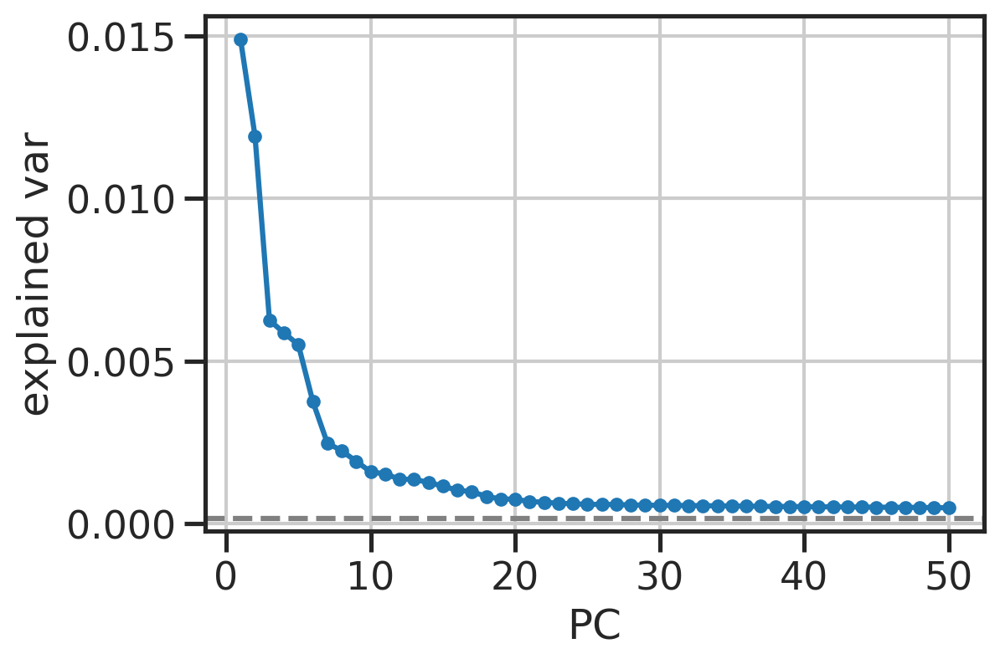

In [19]:
# plt.plot(np.cumsum(pca.explained_variance_ratio_), '-o')
fig, ax = plt.subplots(figsize=(6,4))
ax.plot(np.arange(len(pca.explained_variance_ratio_))+1, pca.explained_variance_ratio_, '-o', markersize=5)
ax.axhline(1/lognorm.shape[1], linestyle='--', color='gray')
ax.set_xlabel('PC')
ax.set_ylabel('explained var')

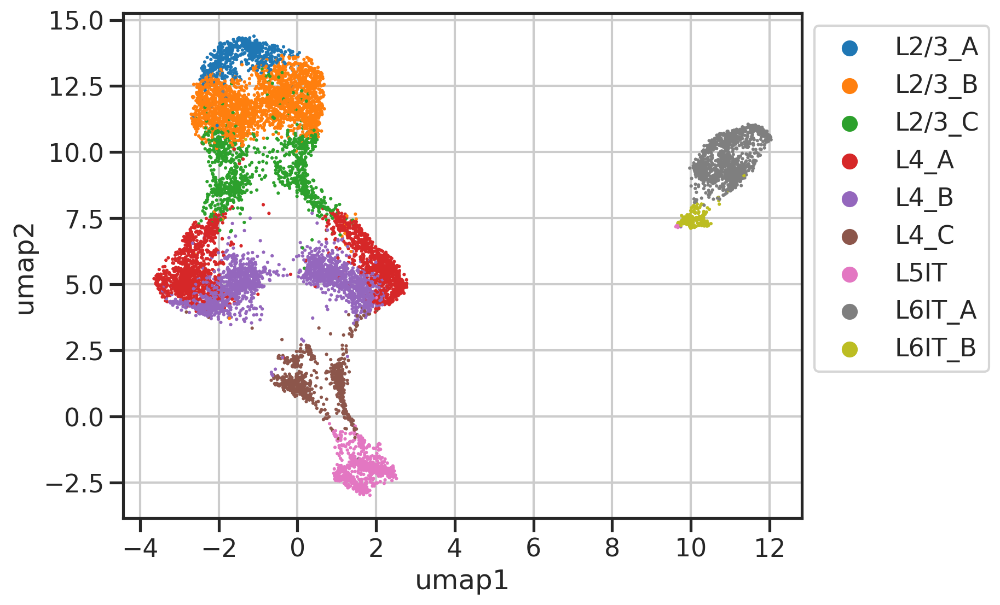

In [20]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='umap1', y='umap2', 
                hue='type',
                # hue='samp',
                # hue_order=list(palette.keys()),
                # palette=palette,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

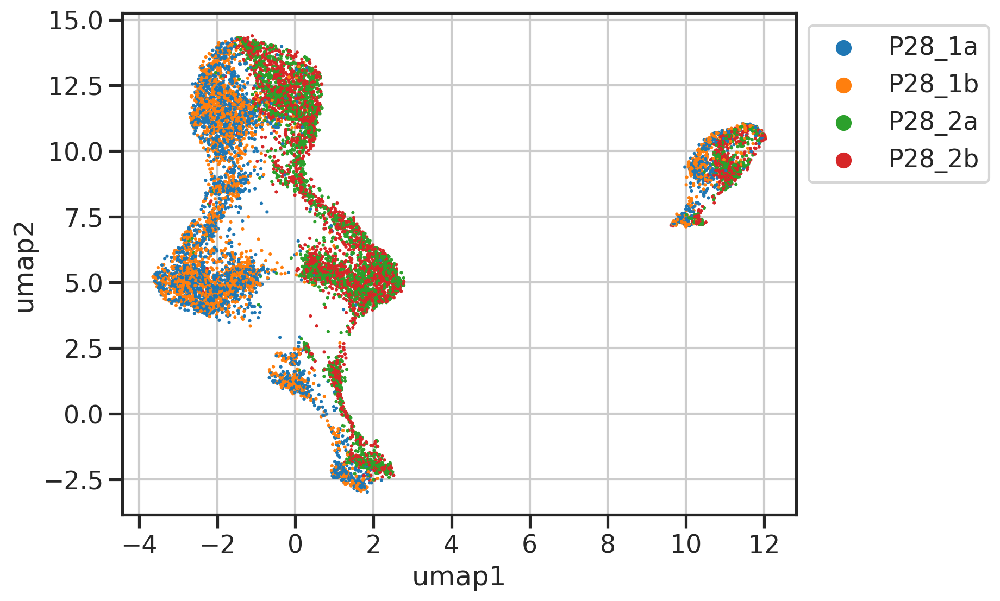

In [21]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='umap1', y='umap2', 
                # hue='type',
                hue='samp',
                # hue_order=list(palette.keys()),
                # palette=palette,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

In [22]:
def plot_pcs(res, npc, hue):
    fig, axs = plt.subplots(npc-1,npc-1,figsize=(6*(npc-1),5*(npc-1)))
    for i, j in itertools.combinations(range(npc), 2):
        legend = False
        if (i,j) == (0,1): legend=True

        x, y = f"PC{j+1}", f"PC{i+1}"
        ax = axs[i,j-1]

        sns.scatterplot(data=res.sample(frac=1, replace=False), 
                        x=x, y=y, 
                        hue=hue,
                        # hue_order=list(palette.keys()),
                        # palette=palette,
                        s=5, edgecolor='none', 
                        legend=legend,
                        ax=ax,
                       )
        sns.despine(ax=ax)
    axs[0,0].legend(bbox_to_anchor=(0.5, -0.2), loc='upper center')

    for i, j in itertools.product(range(npc-1), range(npc-1)):
        if j<i:
            ax = axs[i,j]
            ax.axis('off')

    plt.show()

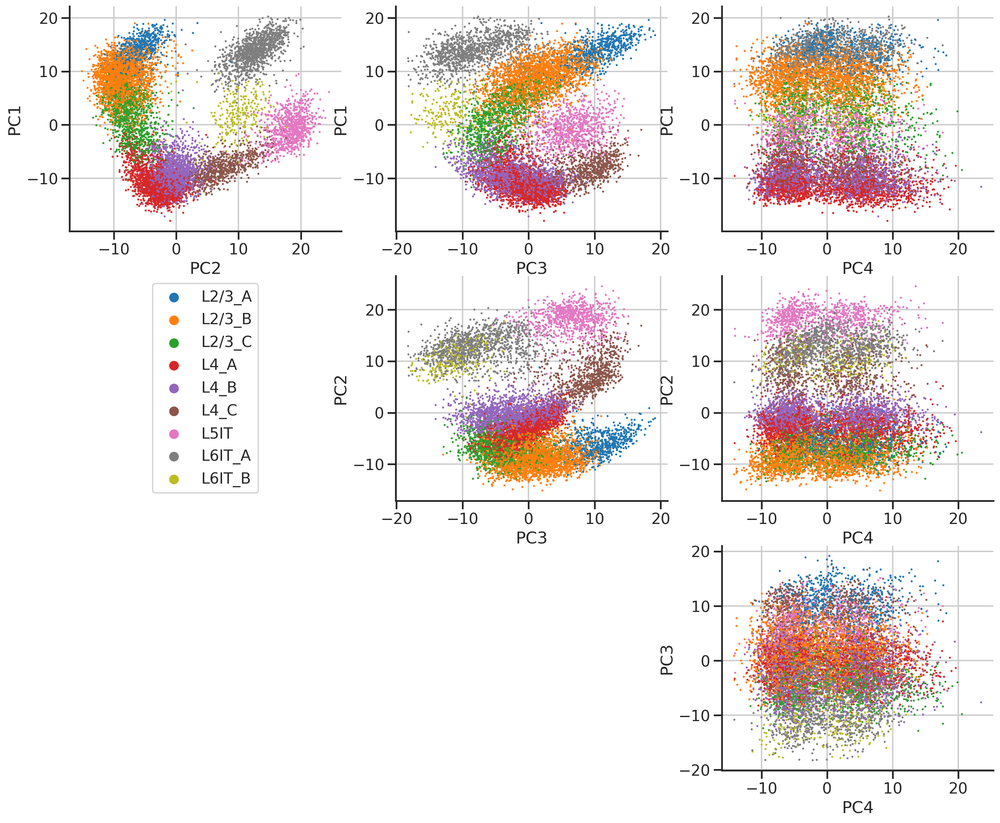

In [23]:
plot_pcs(res, 4, 'type')

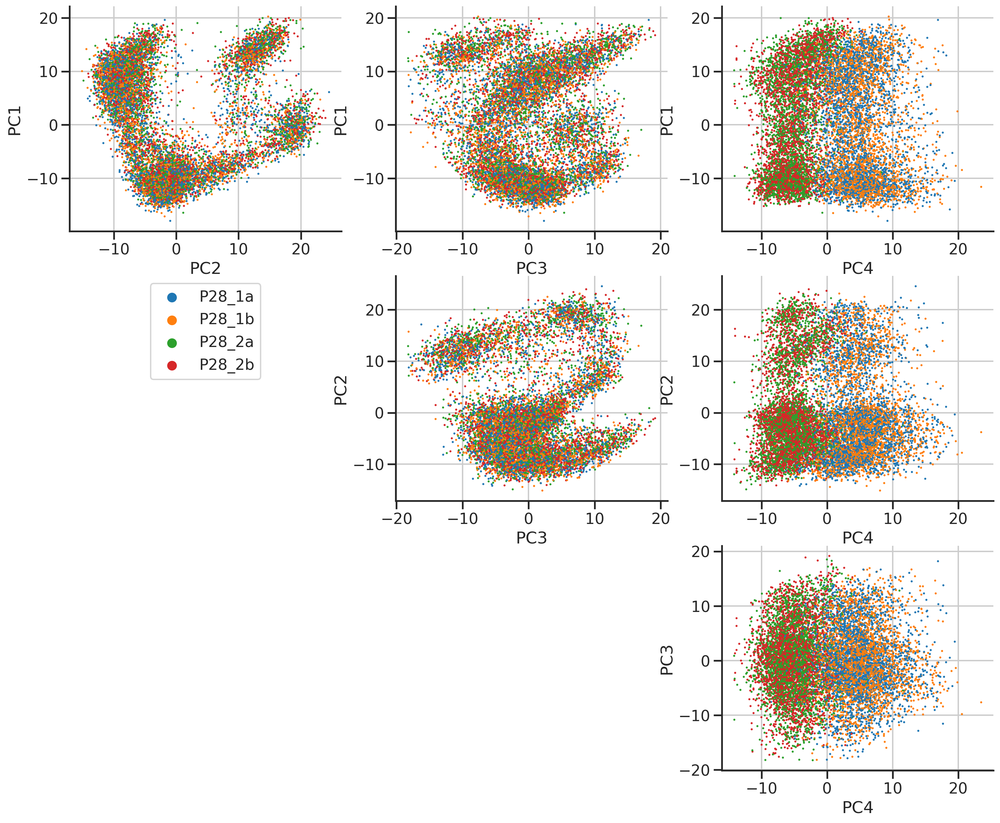

In [24]:
plot_pcs(res, 4, 'samp')

# ptime analysis

In [25]:
adata = adata_sel
adata

View of AnnData object with n_obs × n_vars = 11061 × 6600
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond', 'easitype'
    layers: 'norm', 'lognorm'

In [26]:
adata.obsm['X_pca'] = pcs
sc.pp.neighbors(adata, n_neighbors=50, use_rep='X_pca')
sc.tl.diffmap(adata)
adata.uns['iroot'] = np.argmax(pcs[:,0]+pcs[:,2]) # max PC1+PC4
sc.tl.dpt(adata)
res['ptime'] = adata.obs['dpt_pseudotime'].values
cellidx = np.argsort(res['ptime'].values)

In [27]:

# # # gene ptime
# # weights = ((lognorm+1e-10)/(lognorm.sum(axis=0)+1e-10))
# # gptime  = res['ptime'].values.dot(weights)
# # geneidx = np.argsort(gptime)

# # Use P28 ordering
# f = '../../results/gene_ptime_P28_L23_Mar27.tsv'
# gpt = pd.read_csv(f)
# gpt = gpt['gene_ptime'].values
# geneidx2 = np.argsort(gpt)

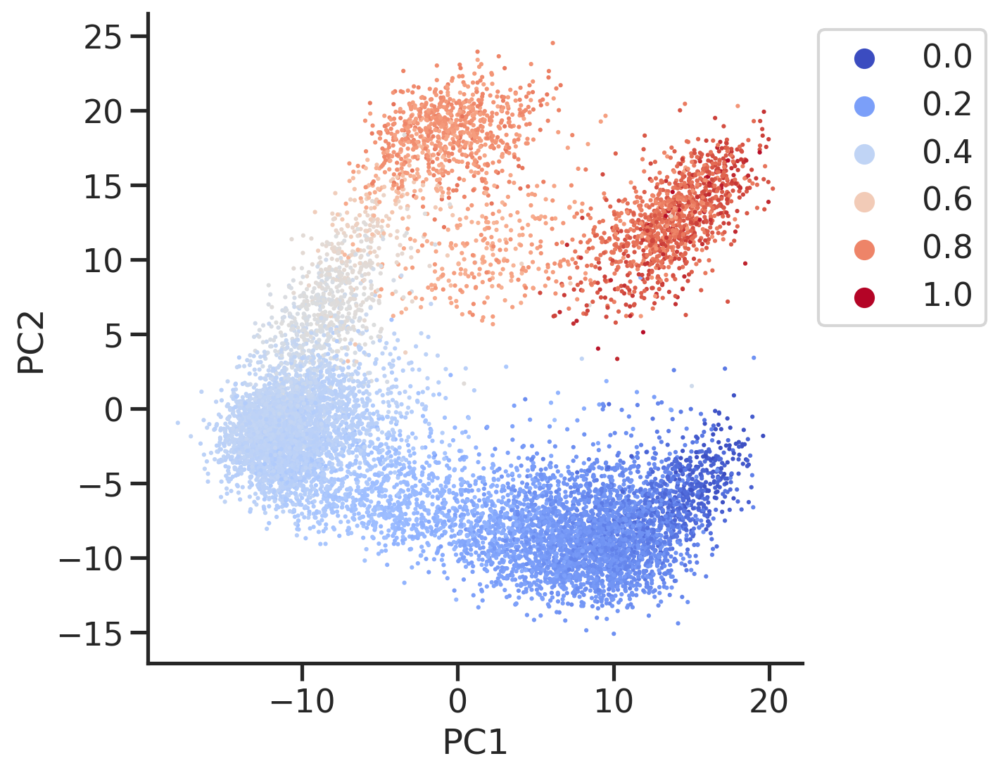

In [28]:
fig, ax = plt.subplots(figsize=(6,6))
sns.scatterplot(data=res, 
                x='PC1',
                y='PC2',
                hue='ptime',
                # hue_order=np.sort(adata.obs['cluster'].unique()),
                edgecolor='none',
                s=5,
                ax=ax,
                palette='coolwarm',
               )
# ax.set_xlabel(f'PC1 ({pca_v[0]*100:.1f}% var)')
# ax.set_ylabel(f'PC2 ({pca_v[1]*100:.1f}% var)')

ax.legend(bbox_to_anchor=(1,1), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
# powerplots.savefig_autodate(fig, os.path.join(fig_dir, 'easifish_pca_proj.pdf'))
plt.show()

04-18 12:11:38 - No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


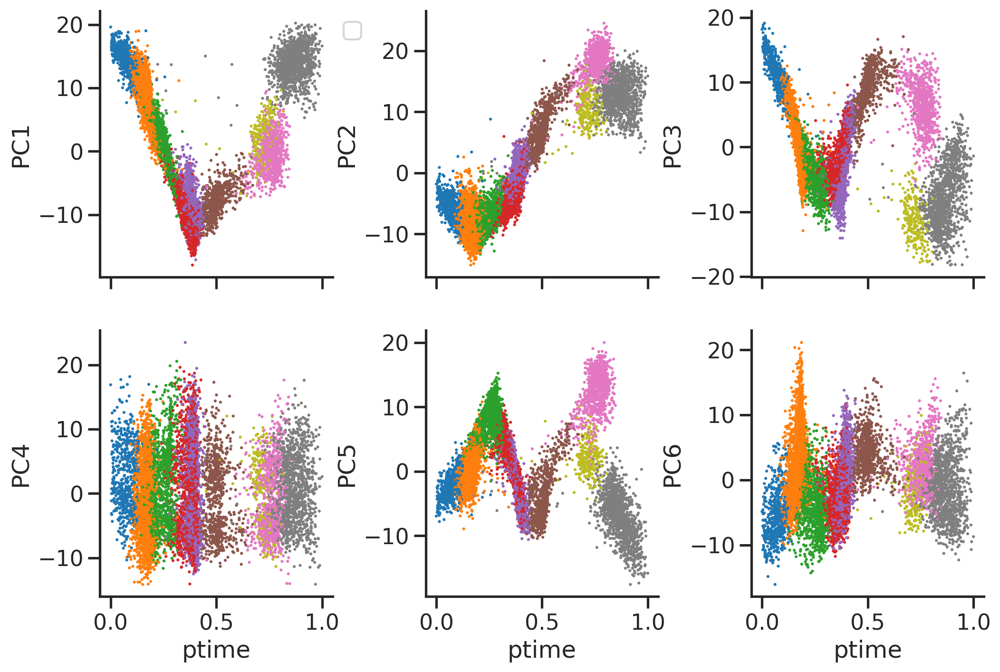

In [29]:
fig, axs = plt.subplots(2, 3, figsize=(4*3,4*2), sharex=True)
for i, ax in enumerate(axs.flat):
    sns.scatterplot(data=res, 
                    x='ptime',
                    y=f'PC{i+1}',
                    hue='type',
                    edgecolor='none',
                    s=5,
                    ax=ax,
                    legend=False,
                   )
    ax.grid(False)
    sns.despine(ax=ax)
axs.flat[0].legend(bbox_to_anchor=(1,1), loc='upper left')
# powerplots.savefig_autodate(fig, os.path.join(fig_dir, 'easifish_pca_proj.pdf'))
fig.subplots_adjust(wspace=0.4)
plt.show()

# check PCs - what genes?
- find some fluctuation genes?

In [30]:
pc_weights = pca.components_
pc_weights.shape

(50, 6600)

In [31]:
pc1_gidx = np.argsort(np.abs( pc_weights[0]))[::-1]
pc1_gidx_up =     np.argsort( pc_weights[0])[::-1]
pc1_gidx_dn =     np.argsort(-pc_weights[0])[::-1]

In [32]:
pc2_gidx = np.argsort(np.abs(pc_weights[1]))[::-1]
pc2_gidx_up = np.argsort(pc_weights[1])[::-1]
pc2_gidx_dn = np.argsort(-pc_weights[1])[::-1]

In [33]:
pc3_gidx = np.argsort(np.abs(pc_weights[2]))[::-1]
pc3_gidx_up = np.argsort(pc_weights[2])[::-1]
pc3_gidx_dn = np.argsort(-pc_weights[2])[::-1]

In [34]:
pc4_gidx = np.argsort(np.abs(pc_weights[3]))[::-1]
pc4_gidx_up = np.argsort(pc_weights[3])[::-1]
pc4_gidx_dn = np.argsort(-pc_weights[3])[::-1]

In [35]:
pc5_gidx = np.argsort(np.abs( pc_weights[4]))[::-1]
pc5_gidx_up =     np.argsort( pc_weights[4])[::-1]
pc5_gidx_dn =     np.argsort(-pc_weights[4])[::-1]

In [36]:
lognorm = np.array(adata_sel.layers['lognorm'].todense())
zlognorm = zscore(lognorm, axis=0)

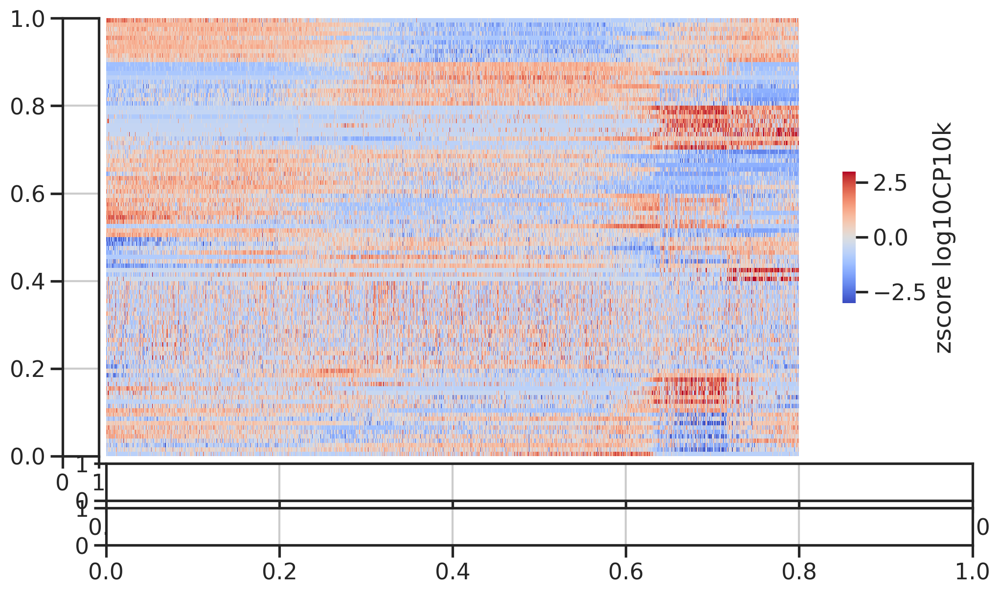

In [37]:
mosaic = ("B"+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")
# print(mosaic)
# gidx = np.hstack([pc4_gidx_up[:10], pc4_gidx_dn[:10]])
# gidx = np.hstack([pc1_gidx_up[:10], pc1_gidx_dn[:10]])
# gidx = np.hstack([pc2_gidx_up[:10], pc2_gidx_dn[:10]])
gidx = np.hstack([
    pc1_gidx_up[:10], pc1_gidx_dn[:10], 
    pc2_gidx_up[:10], pc2_gidx_dn[:10], 
    pc3_gidx_up[:10], pc3_gidx_dn[:10], 
    pc4_gidx_up[:10], pc4_gidx_dn[:10], 
    pc5_gidx_up[:10], pc5_gidx_dn[:10], 
])

fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
ax = axdict['A']
sns.heatmap(zlognorm[cellidx][:,gidx].T,
            xticklabels=False,
            yticklabels=False,
            cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
            center=0,
            vmax=3,
            vmin=-3,
            cmap='coolwarm',
            rasterized=True,
            ax=ax,
           )

# ax = axdict['B']
# sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
#             xticklabels=False,
#             yticklabels=100,
#             cmap=cmap_d1,
#             cbar=False,
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_ylabel('Genes')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

# ax = axdict['C']
# sns.heatmap(pd.factorize(types[cellidx], sort=True)[0].reshape(-1,1).T, 
#             xticklabels=False,
#             yticklabels=False,
#             # cmap=cmap_d1,
#             cbar_kws=dict(ticks=[0,1,2], shrink=1.2, aspect=3, label='type'),
#             rasterized=True,
#             ax=ax, 
#            )
# fig.axes[-1].set_yticklabels(['A','B','C'], fontsize=10)
# fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

# ax = axdict['D']
# sns.heatmap(pd.factorize(samps[cellidx], sort=True)[0].reshape(-1,1).T, 
#             xticklabels=1000,
#             yticklabels=False,
#             # cmap=cmap_d2,
#             cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_xlabel('Cells')
# fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

# fig.subplots_adjust(hspace=0.5)
# fig.suptitle(sample)
# powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
plt.show()

# order genes?
- genes mark ptime?
- genes were reused?

In [38]:
omat = zlognorm[cellidx]
omat

array([[ 1.0460801  , -0.48910215 , -0.061953273, ..., -0.51729834 ,
         0.9857191  , -0.28890902 ],
       [ 1.7184647  ,  2.9396226  , -0.061953273, ..., -0.51729834 ,
         1.2206818  , -0.28890902 ],
       [ 1.7862848  , -0.48910215 , -0.061953273, ..., -0.51729834 ,
         0.23716062 , -0.28890902 ],
       ...,
       [ 1.9201832  , -0.48910215 , -0.061953273, ..., -0.51729834 ,
         0.8040534  , -0.28890902 ],
       [ 0.90503603 ,  3.5923393  , 18.842287   , ..., -0.51729834 ,
         0.2642795  , -0.28890902 ],
       [ 1.2589973  , -0.48910215 , -0.061953273, ..., -0.51729834 ,
         0.2573107  , -0.28890902 ]], dtype=float32)

In [39]:
num_cells = adata.obs['Subclass'].value_counts().sort_index()
cumsum_cells = np.cumsum(num_cells)
num_cells, cumsum_cells

(L2/3    4044
 L4      4732
 L5IT     849
 L6IT    1436
 Name: Subclass, dtype: int64,
 L2/3     4044
 L4       8776
 L5IT     9625
 L6IT    11061
 Name: Subclass, dtype: int64)

In [40]:
def get_mi(x, ymat, nbins=20):
    """
    """
    # MI for L2/3
    nbins = 20
    xb = pd.cut(x, nbins, labels=np.arange(nbins))

    mi = []
    for i in np.arange(ymat.shape[1]):
        y = ymat[:,i]
        yb = pd.cut(y, nbins, labels=np.arange(nbins))
        _mi = metrics.mutual_info_score(xb, yb)
        mi.append(_mi)
    mi = np.array(mi)
    return mi


In [41]:
%%time
# MI for all
x = res['ptime'].values[cellidx]
ymat = omat
mi = get_mi(x, ymat)

CPU times: user 14.4 s, sys: 0 ns, total: 14.4 s
Wall time: 14.4 s


In [42]:
%%time
# MI for L2/3
lcut, rcut =  0, cumsum_cells[1]
x = res['ptime'].values[cellidx][lcut:rcut]
ymat = omat[lcut:rcut]
mi_l234 = get_mi(x, ymat)

CPU times: user 12.6 s, sys: 0 ns, total: 12.6 s
Wall time: 12.6 s


In [43]:
%%time
# MI for L2/3
lcut, rcut =  0, cumsum_cells[0]
x = res['ptime'].values[cellidx][lcut:rcut]
ymat = omat[lcut:rcut]
mi_l23 = get_mi(x, ymat)

CPU times: user 9.16 s, sys: 0 ns, total: 9.16 s
Wall time: 9.16 s


In [44]:
%%time
# MI for L4
lcut, rcut =  cumsum_cells[0], cumsum_cells[1]
x = res['ptime'].values[cellidx][lcut:rcut]
ymat = omat[lcut:rcut]
mi_l4 = get_mi(x, ymat)

CPU times: user 9.61 s, sys: 0 ns, total: 9.61 s
Wall time: 9.61 s


In [45]:
%%time
# MI for L56
lcut, rcut =  cumsum_cells[1], cumsum_cells[3]
x = res['ptime'].values[cellidx][lcut:rcut]
ymat = omat[lcut:rcut]
mi_l56 = get_mi(x, ymat)

CPU times: user 7.96 s, sys: 0 ns, total: 7.96 s
Wall time: 7.96 s


In [46]:
%%time
# MI for L5
lcut, rcut =  cumsum_cells[1], cumsum_cells[2]
x = res['ptime'].values[cellidx][lcut:rcut]
ymat = omat[lcut:rcut]
mi_l5 = get_mi(x, ymat)

CPU times: user 6.87 s, sys: 0 ns, total: 6.87 s
Wall time: 6.88 s


In [47]:
%%time
# MI for L6
lcut, rcut =  cumsum_cells[2], cumsum_cells[3]
x = res['ptime'].values[cellidx][lcut:rcut]
ymat = omat[lcut:rcut]
mi_l6 = get_mi(x, ymat)

CPU times: user 7.33 s, sys: 0 ns, total: 7.33 s
Wall time: 7.34 s


In [48]:
gidx_all = np.argsort(mi)[::-1]
gidx_l23 = np.argsort(mi_l23)[::-1]
gidx_l234 = np.argsort(mi_l234)[::-1]
gidx_l4  = np.argsort(mi_l4)[::-1]
gidx_l56  = np.argsort(mi_l56)[::-1]
gidx_l5  = np.argsort(mi_l5)[::-1]
gidx_l6  = np.argsort(mi_l6)[::-1]

Text(0.5, 0, 'genes')

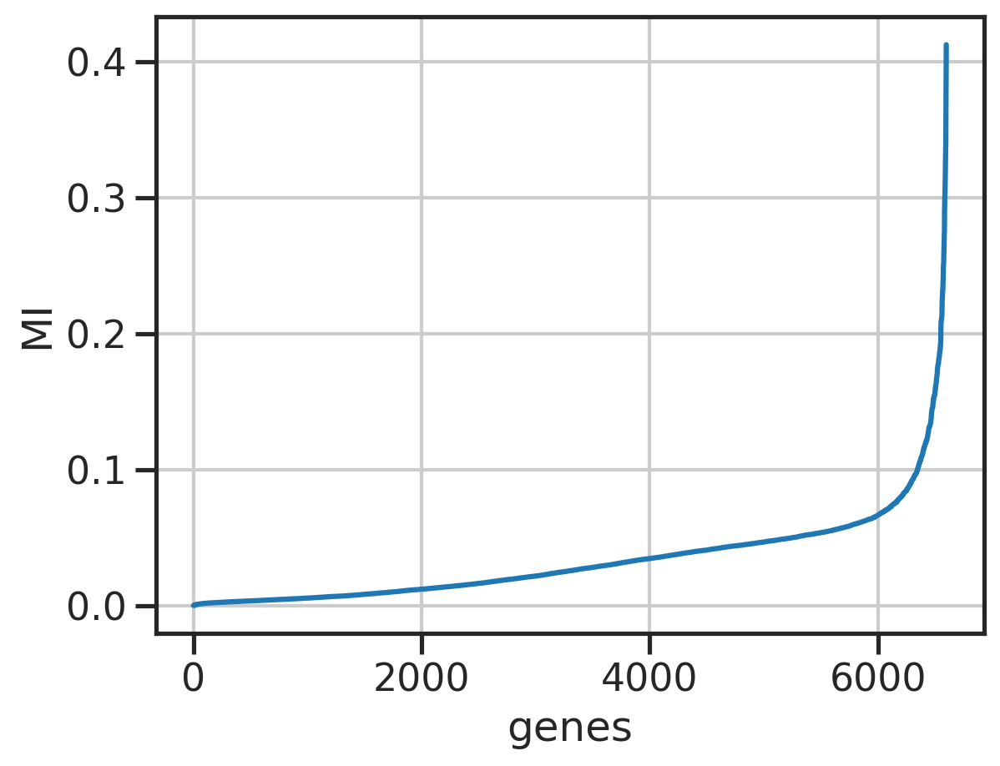

In [49]:
plt.plot(np.sort(mi_l23))
plt.ylabel('MI')
plt.xlabel('genes')

Text(0.5, 0, 'genes')

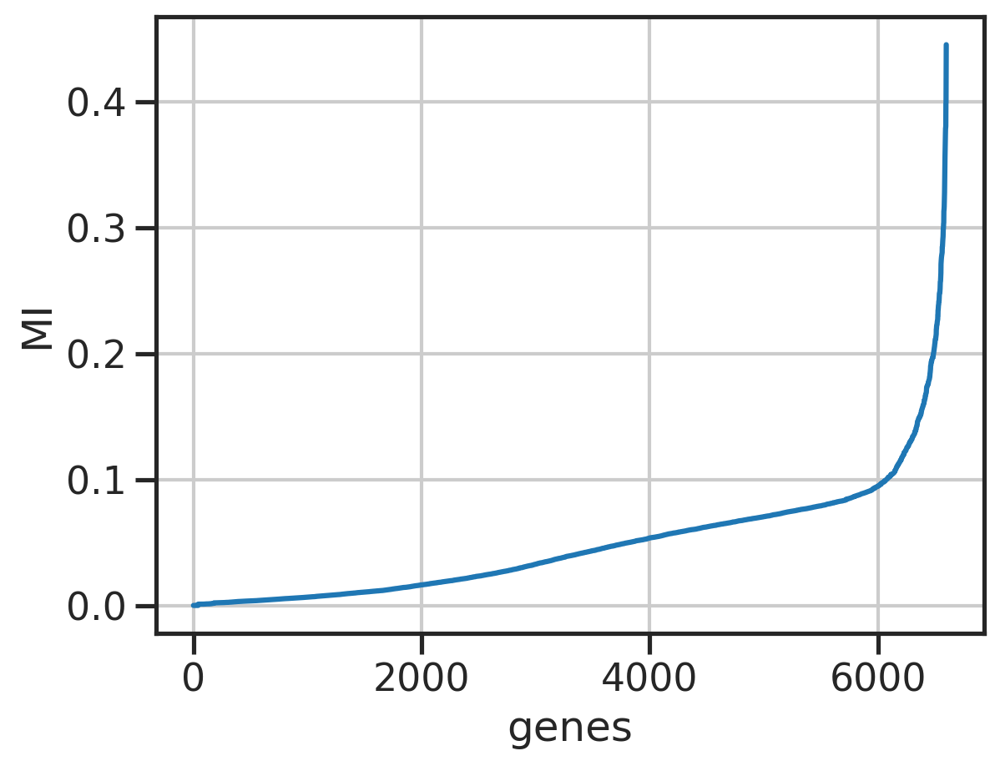

In [50]:
plt.plot(np.sort(mi_l56))
plt.ylabel('MI')
plt.xlabel('genes')

In [51]:
np.sum(mi_l23 > 0.2), np.sum(mi_l4 > 0.2), np.sum(mi_l56 > 0.2)

(48, 30, 113)

In [52]:
# np.intersect1d(genes_sel[mi_l23>0.2], genes_l23).shape

Text(0.5, 0, 'MI L23')

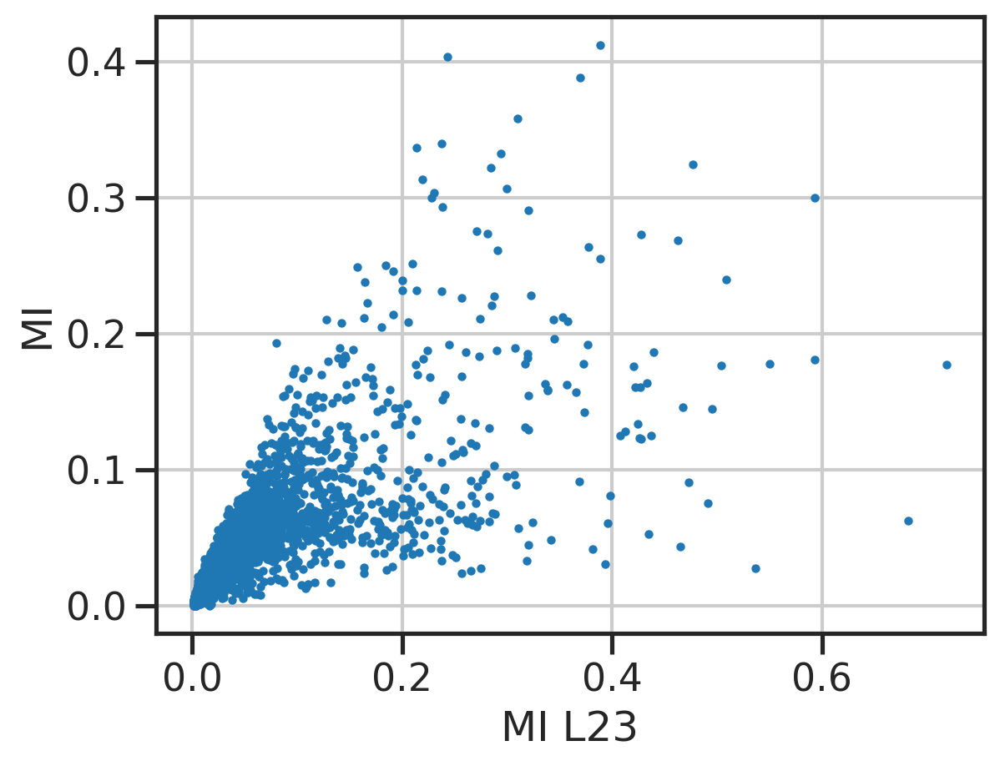

In [53]:
plt.scatter(mi, mi_l23, s=5)
plt.ylabel('MI')
plt.xlabel('MI L23')

Text(0, 0.5, 'MI L4')

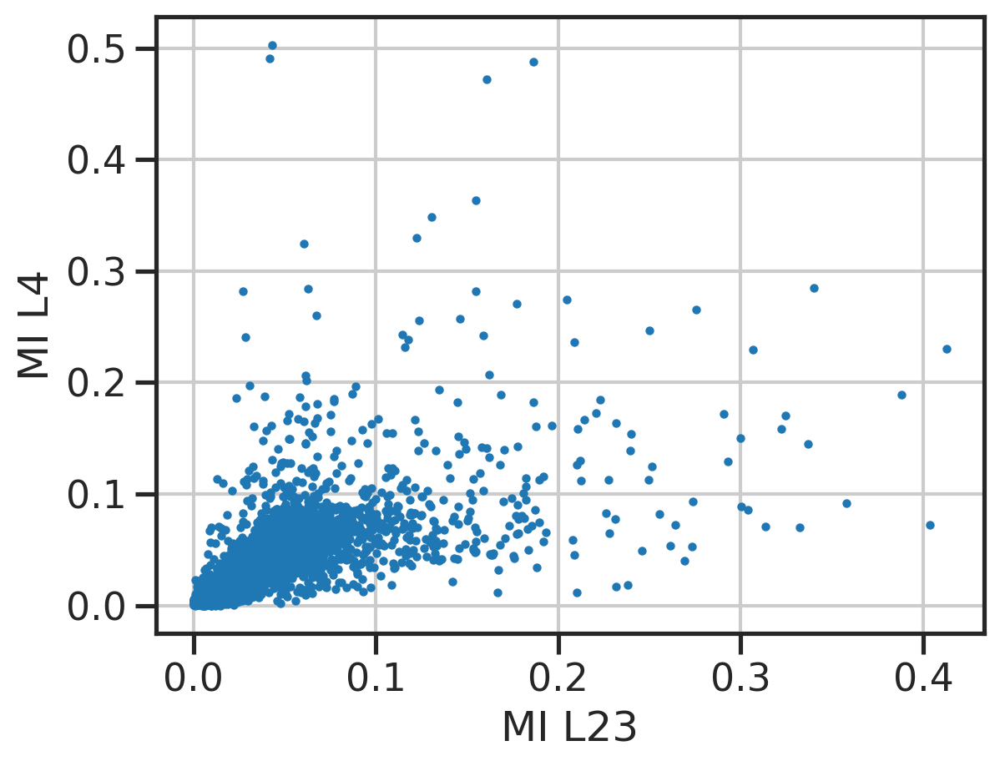

In [54]:
plt.scatter(mi_l23, mi_l4, s=5)
plt.xlabel('MI L23')
plt.ylabel('MI L4')

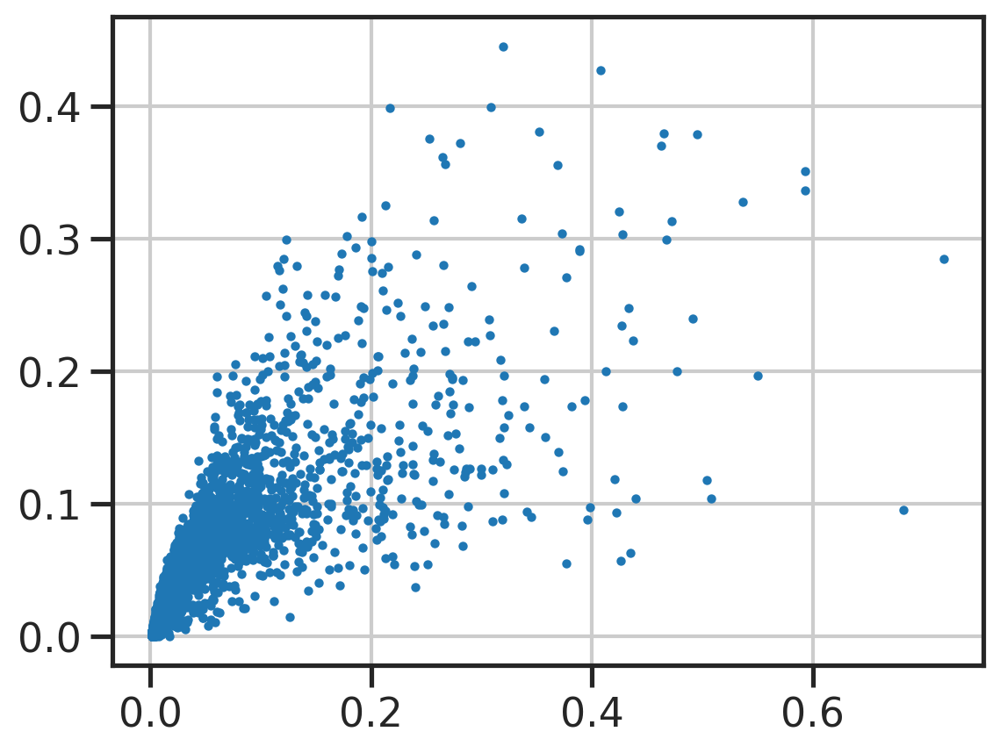

In [55]:
plt.scatter(mi, mi_l56, s=5)
# plt.xlabel('MI L23')
# plt.ylabel('MI L4')

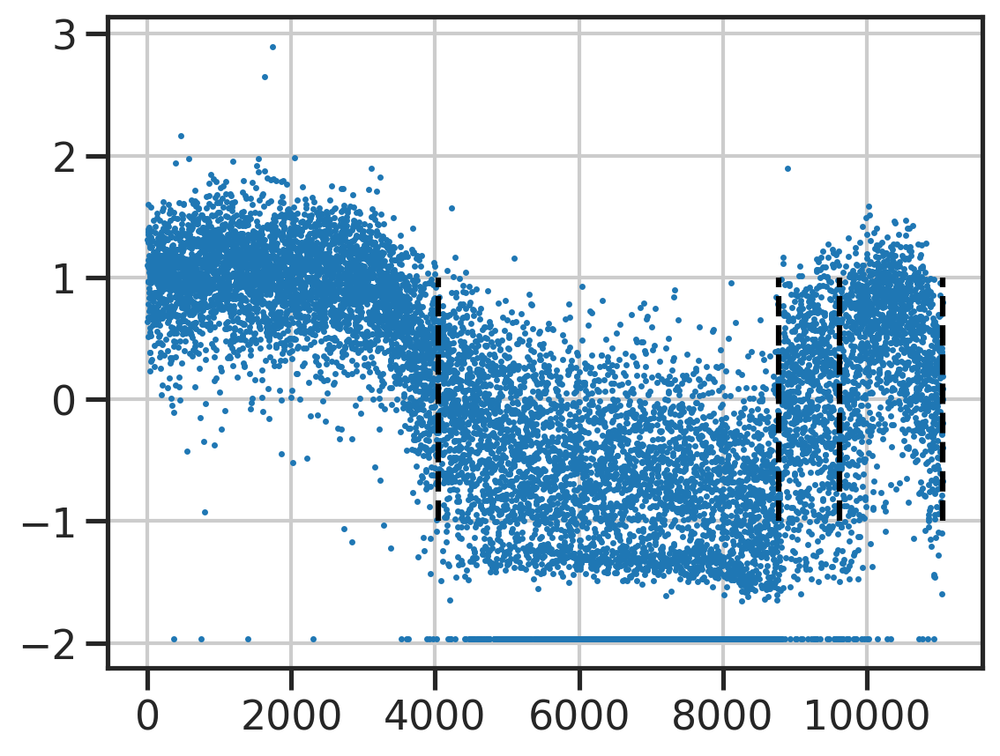

In [56]:
plt.scatter(np.arange(len(omat)), omat[:,gidx_all[4]], s=1)
plt.vlines(np.cumsum(num_cells.values), ymin=-1, ymax=1, color='black', linestyle='--')

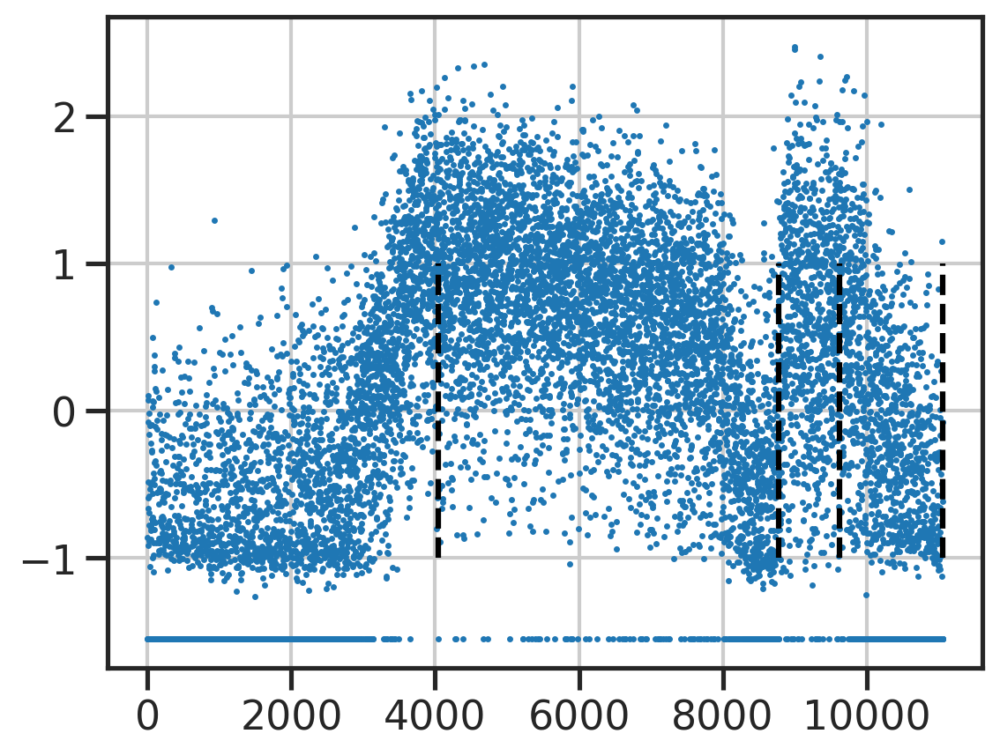

In [57]:
plt.scatter(np.arange(len(omat)), omat[:,gidx_l23[0]], s=1)
plt.vlines(np.cumsum(num_cells.values), ymin=-1, ymax=1, color='black', linestyle='--')

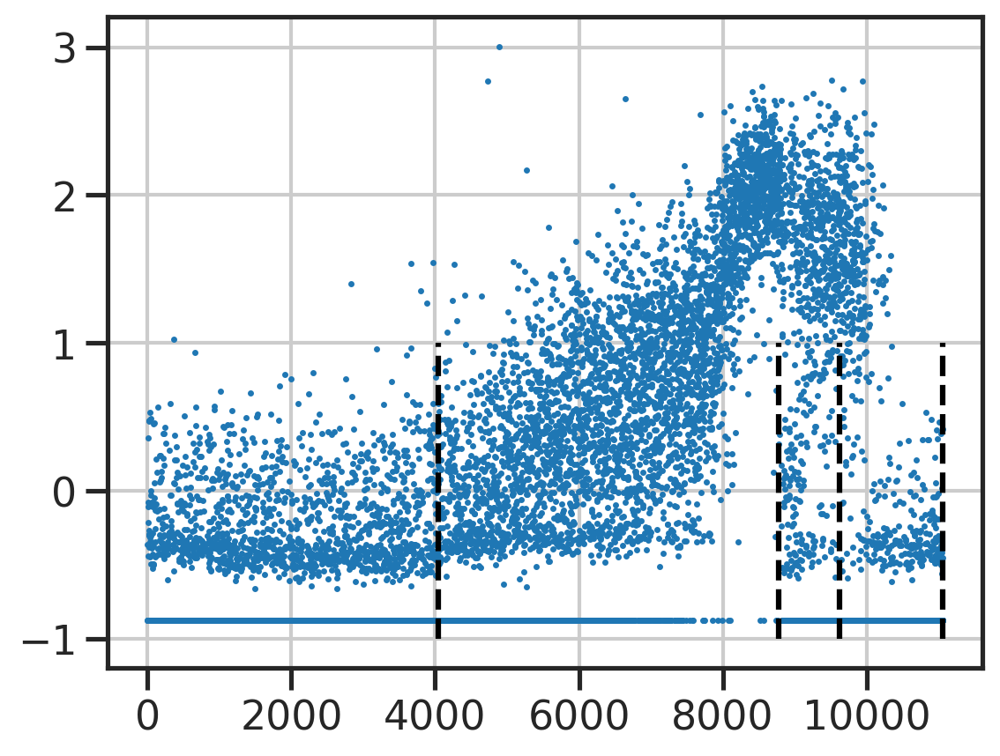

In [58]:
plt.scatter(np.arange(len(omat)), omat[:,gidx_l4[0]], s=1)
plt.vlines(np.cumsum(num_cells.values), ymin=-1, ymax=1, color='black', linestyle='--')

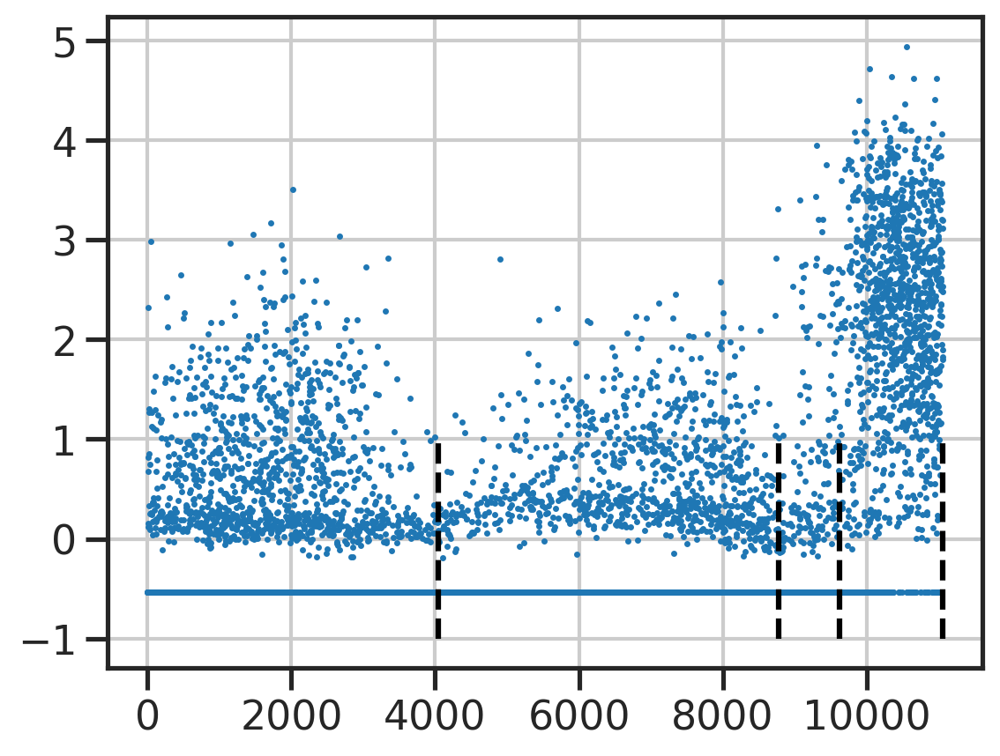

In [59]:
plt.scatter(np.arange(len(omat)), omat[:,gidx_l56[3]], s=1)
plt.vlines(np.cumsum(num_cells.values), ymin=-1, ymax=1, color='black', linestyle='--')

In [60]:
def get_gptime(adata):
    """
    """

    lognorm = np.array(adata.layers['lognorm'].todense())
    # # gene ptime
    weights = ((lognorm+1e-10)/(lognorm.sum(axis=0)+1e-10))

    gptime  = adata.obs['dpt_pseudotime'].values.dot(weights)
    gidx = np.argsort(gptime)
    return gptime, gidx

In [61]:
cond = mi_l234 > 0.2
print(cond.shape, cond.sum())

genes_grad_l234 = genes_sel[cond]
adata_grad_l234 = adata[adata.obs['Subclass'].isin(['L2/3', 'L4']), genes_grad_l234]

lognorm = np.array(adata_grad_l234.layers['lognorm'].todense())
zlognorm = zscore(lognorm, axis=0)

# get gene order
gptime_this, gptime_idx_this = get_gptime(adata_grad_l234)
cellidx_this = np.argsort(adata_grad_l234.obs['dpt_pseudotime'])

(6600,) 133


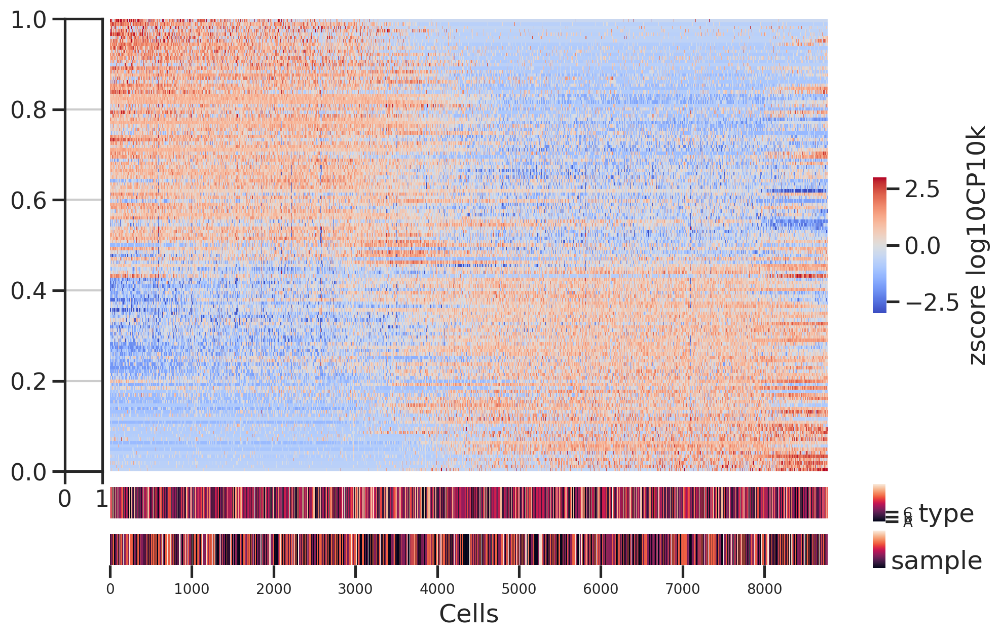

In [62]:
geneidx = gptime_idx_this
mosaic = ("B"+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")
# print(mosaic)

fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
ax = axdict['A']
sns.heatmap(zlognorm[cellidx_this][:,geneidx].T,
            xticklabels=False,
            yticklabels=False,
            cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
            center=0,
            vmax=3,
            vmin=-3,
            cmap='coolwarm',
            rasterized=True,
            ax=ax,
           )

# ax = axdict['B']
# sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
#             xticklabels=False,
#             yticklabels=100,
#             cmap=cmap_d1,
#             cbar=False,
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_ylabel('Genes')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

ax = axdict['C']
sns.heatmap(pd.factorize(types[cellidx_this], sort=True)[0].reshape(-1,1).T, 
            xticklabels=False,
            yticklabels=False,
            # cmap=cmap_d1,
            cbar_kws=dict(ticks=[0,1,2], shrink=1.2, aspect=3, label='type'),
            rasterized=True,
            ax=ax, 
           )
fig.axes[-1].set_yticklabels(['A','B','C'], fontsize=10)
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

ax = axdict['D']
sns.heatmap(pd.factorize(samps[cellidx_this], sort=True)[0].reshape(-1,1).T, 
            xticklabels=1000,
            yticklabels=False,
            # cmap=cmap_d2,
            cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
            rasterized=True,
            ax=ax, 
           )
ax.set_xlabel('Cells')
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

fig.subplots_adjust(hspace=0.5)
# fig.suptitle(sample)
# powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
plt.show()

In [63]:
cond = mi_l23 > 0.2
print(cond.shape, cond.sum())

genes_grad_l23 = genes_sel[cond]
adata_grad_l23 = adata[adata.obs['Subclass']=='L2/3',genes_grad_l23]

lognorm = np.array(adata_grad_l23.layers['lognorm'].todense())
zlognorm = zscore(lognorm, axis=0)

# get gene order
gptime_this, gptime_idx_this = get_gptime(adata_grad_l23)
cellidx_this = np.argsort(adata_grad_l23.obs['dpt_pseudotime'])

(6600,) 48


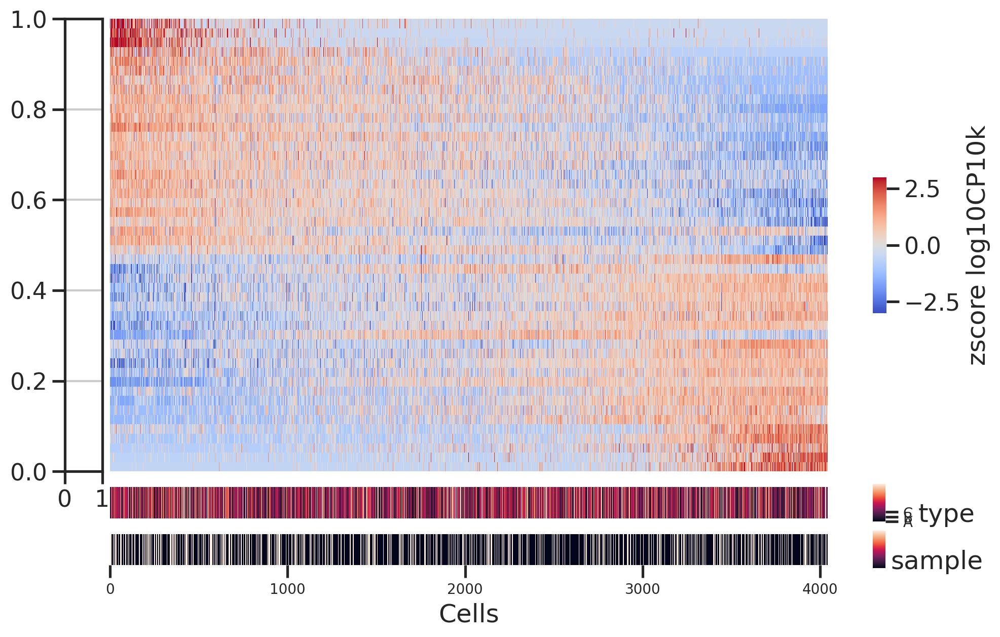

In [64]:
geneidx = gptime_idx_this
mosaic = ("B"+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")
# print(mosaic)

fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
ax = axdict['A']
sns.heatmap(zlognorm[cellidx_this][:,geneidx].T,
            xticklabels=False,
            yticklabels=False,
            cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
            center=0,
            vmax=3,
            vmin=-3,
            cmap='coolwarm',
            rasterized=True,
            ax=ax,
           )

# ax = axdict['B']
# sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
#             xticklabels=False,
#             yticklabels=100,
#             cmap=cmap_d1,
#             cbar=False,
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_ylabel('Genes')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

ax = axdict['C']
sns.heatmap(pd.factorize(types[cellidx_this], sort=True)[0].reshape(-1,1).T, 
            xticklabels=False,
            yticklabels=False,
            # cmap=cmap_d1,
            cbar_kws=dict(ticks=[0,1,2], shrink=1.2, aspect=3, label='type'),
            rasterized=True,
            ax=ax, 
           )
fig.axes[-1].set_yticklabels(['A','B','C'], fontsize=10)
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

ax = axdict['D']
sns.heatmap(pd.factorize(samps[cellidx_this], sort=True)[0].reshape(-1,1).T, 
            xticklabels=1000,
            yticklabels=False,
            # cmap=cmap_d2,
            cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
            rasterized=True,
            ax=ax, 
           )
ax.set_xlabel('Cells')
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

fig.subplots_adjust(hspace=0.5)
# fig.suptitle(sample)
# powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
plt.show()

In [65]:
cond = mi_l4 > 0.2
print(cond.shape, cond.sum())

genes_grad_l4 = genes_sel[cond]
adata_grad_l4 = adata[adata.obs['Subclass']=='L4',genes_grad_l4]

lognorm = np.array(adata_grad_l4.layers['lognorm'].todense())
zlognorm = zscore(lognorm, axis=0)

# get gene order
gptime_this, gptime_idx_this = get_gptime(adata_grad_l4)
cellidx_this = np.argsort(adata_grad_l4.obs['dpt_pseudotime'])

(6600,) 30


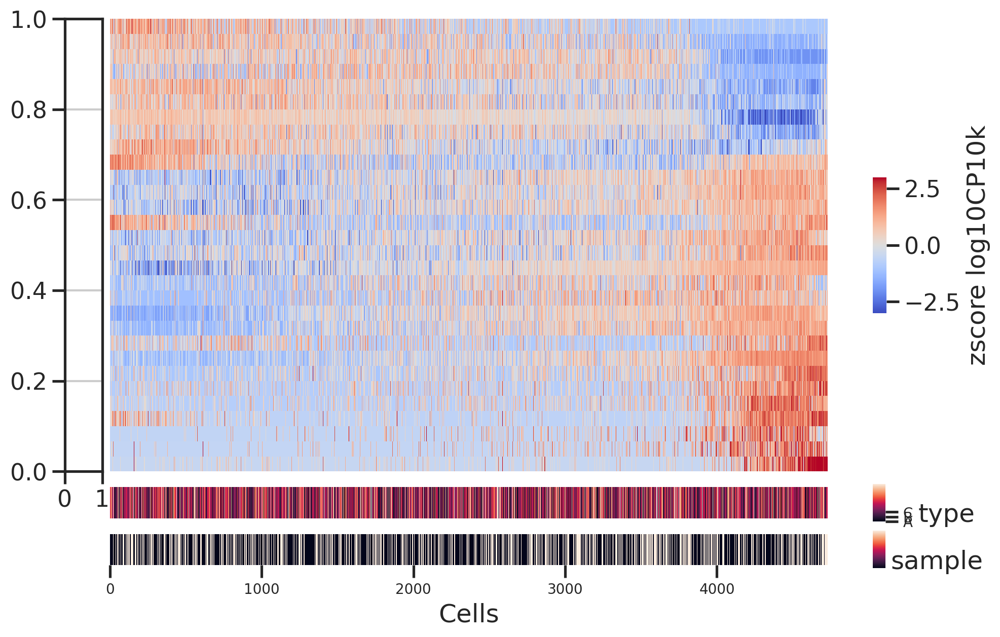

In [66]:
geneidx = gptime_idx_this
mosaic = ("B"+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")
# print(mosaic)

fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
ax = axdict['A']
sns.heatmap(zlognorm[cellidx_this][:,geneidx].T,
            xticklabels=False,
            yticklabels=False,
            cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
            center=0,
            vmax=3,
            vmin=-3,
            cmap='coolwarm',
            rasterized=True,
            ax=ax,
           )

# ax = axdict['B']
# sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
#             xticklabels=False,
#             yticklabels=100,
#             cmap=cmap_d1,
#             cbar=False,
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_ylabel('Genes')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

ax = axdict['C']
sns.heatmap(pd.factorize(types[cellidx_this], sort=True)[0].reshape(-1,1).T, 
            xticklabels=False,
            yticklabels=False,
            # cmap=cmap_d1,
            cbar_kws=dict(ticks=[0,1,2], shrink=1.2, aspect=3, label='type'),
            rasterized=True,
            ax=ax, 
           )
fig.axes[-1].set_yticklabels(['A','B','C'], fontsize=10)
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

ax = axdict['D']
sns.heatmap(pd.factorize(samps[cellidx_this], sort=True)[0].reshape(-1,1).T, 
            xticklabels=1000,
            yticklabels=False,
            # cmap=cmap_d2,
            cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
            rasterized=True,
            ax=ax, 
           )
ax.set_xlabel('Cells')
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

fig.subplots_adjust(hspace=0.5)
# fig.suptitle(sample)
# powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
plt.show()

In [67]:
cond = mi_l56 > 0.2
print(cond.shape, cond.sum())

genes_grad_l56 = genes_sel[cond]
adata_grad_l56 = adata[adata.obs['Subclass'].isin(['L5IT', 'L6IT']), genes_grad_l56]

lognorm = np.array(adata_grad_l56.layers['lognorm'].todense())
zlognorm = zscore(lognorm, axis=0)

# get gene order
gptime_this, gptime_idx_this = get_gptime(adata_grad_l56)
cellidx_this = np.argsort(adata_grad_l56.obs['dpt_pseudotime'])

(6600,) 113


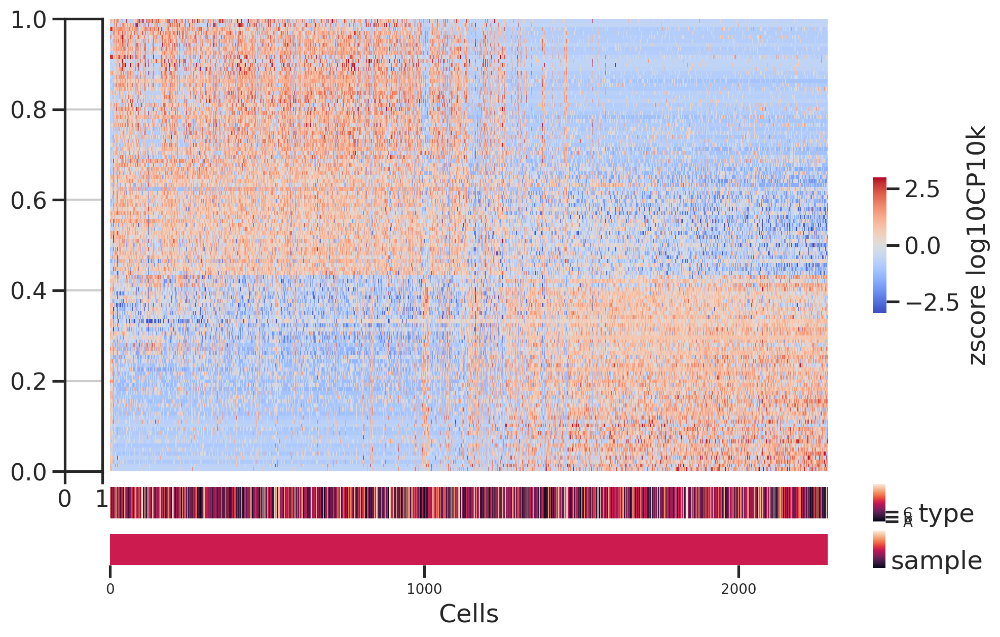

In [68]:
geneidx = gptime_idx_this
mosaic = ("B"+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")
# print(mosaic)

fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
ax = axdict['A']
sns.heatmap(zlognorm[cellidx_this][:,geneidx].T,
            xticklabels=False,
            yticklabels=False,
            cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
            center=0,
            vmax=3,
            vmin=-3,
            cmap='coolwarm',
            rasterized=True,
            ax=ax,
           )

# ax = axdict['B']
# sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
#             xticklabels=False,
#             yticklabels=100,
#             cmap=cmap_d1,
#             cbar=False,
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_ylabel('Genes')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

ax = axdict['C']
sns.heatmap(pd.factorize(types[cellidx_this], sort=True)[0].reshape(-1,1).T, 
            xticklabels=False,
            yticklabels=False,
            # cmap=cmap_d1,
            cbar_kws=dict(ticks=[0,1,2], shrink=1.2, aspect=3, label='type'),
            rasterized=True,
            ax=ax, 
           )
fig.axes[-1].set_yticklabels(['A','B','C'], fontsize=10)
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

ax = axdict['D']
sns.heatmap(pd.factorize(samps[cellidx_this], sort=True)[0].reshape(-1,1).T, 
            xticklabels=1000,
            yticklabels=False,
            # cmap=cmap_d2,
            cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
            rasterized=True,
            ax=ax, 
           )
ax.set_xlabel('Cells')
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

fig.subplots_adjust(hspace=0.5)
# fig.suptitle(sample)
# powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
plt.show()

In [69]:
cond = mi_l5 > 0.2
print(cond.shape, cond.sum())

genes_grad_l5 = genes_sel[cond]
adata_grad_l5 = adata[adata.obs['Subclass'].isin(['L5IT']), genes_grad_l5]

lognorm = np.array(adata_grad_l5.layers['lognorm'].todense())
zlognorm = zscore(lognorm, axis=0)

# get gene order
gptime_this, gptime_idx_this = get_gptime(adata_grad_l5)
cellidx_this = np.argsort(adata_grad_l5.obs['dpt_pseudotime'])

(6600,) 209


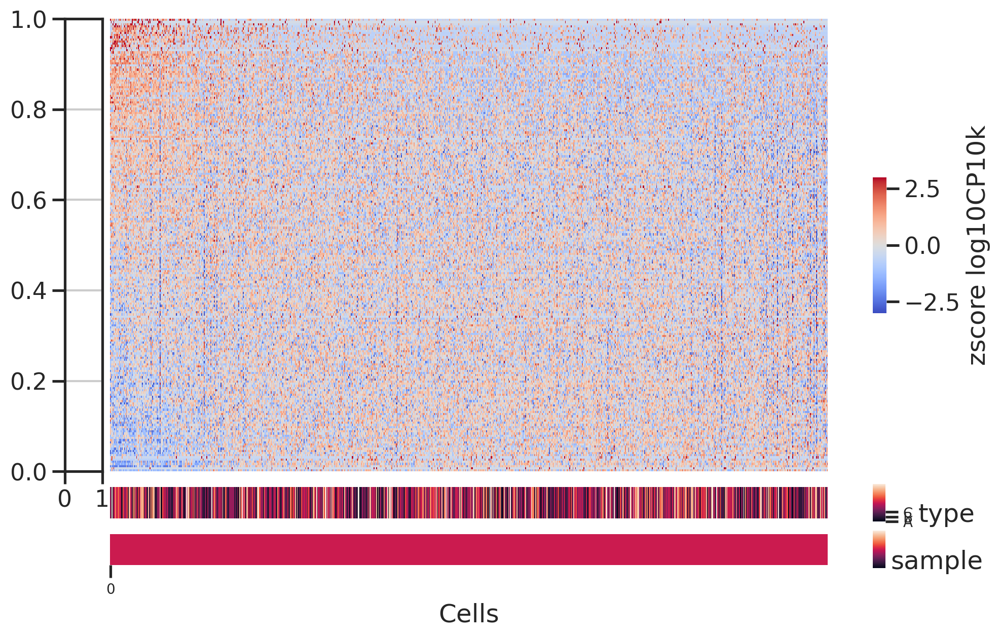

In [70]:
geneidx = gptime_idx_this
mosaic = ("B"+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")
# print(mosaic)

fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
ax = axdict['A']
sns.heatmap(zlognorm[cellidx_this][:,geneidx].T,
            xticklabels=False,
            yticklabels=False,
            cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
            center=0,
            vmax=3,
            vmin=-3,
            cmap='coolwarm',
            rasterized=True,
            ax=ax,
           )

# ax = axdict['B']
# sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
#             xticklabels=False,
#             yticklabels=100,
#             cmap=cmap_d1,
#             cbar=False,
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_ylabel('Genes')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

ax = axdict['C']
sns.heatmap(pd.factorize(types[cellidx_this], sort=True)[0].reshape(-1,1).T, 
            xticklabels=False,
            yticklabels=False,
            # cmap=cmap_d1,
            cbar_kws=dict(ticks=[0,1,2], shrink=1.2, aspect=3, label='type'),
            rasterized=True,
            ax=ax, 
           )
fig.axes[-1].set_yticklabels(['A','B','C'], fontsize=10)
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

ax = axdict['D']
sns.heatmap(pd.factorize(samps[cellidx_this], sort=True)[0].reshape(-1,1).T, 
            xticklabels=1000,
            yticklabels=False,
            # cmap=cmap_d2,
            cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
            rasterized=True,
            ax=ax, 
           )
ax.set_xlabel('Cells')
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

fig.subplots_adjust(hspace=0.5)
# fig.suptitle(sample)
# powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
plt.show()

In [71]:
cond = mi_l6 > 0.2
print(cond.shape, cond.sum())

genes_grad_l6 = genes_sel[cond]
adata_grad_l6 = adata[adata.obs['Subclass'].isin(['L6IT']), genes_grad_l6]

lognorm = np.array(adata_grad_l6.layers['lognorm'].todense())
zlognorm = zscore(lognorm, axis=0)

# get gene order
gptime_this, gptime_idx_this = get_gptime(adata_grad_l6)
cellidx_this = np.argsort(adata_grad_l6.obs['dpt_pseudotime'])

(6600,) 103


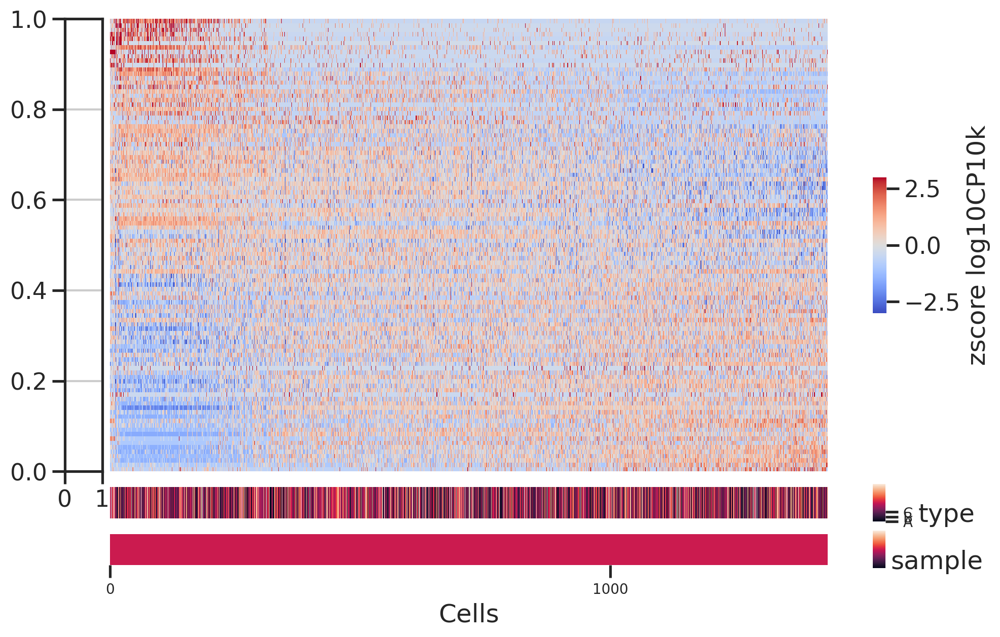

In [72]:
geneidx = gptime_idx_this
mosaic = ("B"+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")
# print(mosaic)

fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
ax = axdict['A']
sns.heatmap(zlognorm[cellidx_this][:,geneidx].T,
            xticklabels=False,
            yticklabels=False,
            cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
            center=0,
            vmax=3,
            vmin=-3,
            cmap='coolwarm',
            rasterized=True,
            ax=ax,
           )

# ax = axdict['B']
# sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
#             xticklabels=False,
#             yticklabels=100,
#             cmap=cmap_d1,
#             cbar=False,
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_ylabel('Genes')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

ax = axdict['C']
sns.heatmap(pd.factorize(types[cellidx_this], sort=True)[0].reshape(-1,1).T, 
            xticklabels=False,
            yticklabels=False,
            # cmap=cmap_d1,
            cbar_kws=dict(ticks=[0,1,2], shrink=1.2, aspect=3, label='type'),
            rasterized=True,
            ax=ax, 
           )
fig.axes[-1].set_yticklabels(['A','B','C'], fontsize=10)
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

ax = axdict['D']
sns.heatmap(pd.factorize(samps[cellidx_this], sort=True)[0].reshape(-1,1).T, 
            xticklabels=1000,
            yticklabels=False,
            # cmap=cmap_d2,
            cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
            rasterized=True,
            ax=ax, 
           )
ax.set_xlabel('Cells')
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

fig.subplots_adjust(hspace=0.5)
# fig.suptitle(sample)
# powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
plt.show()

In [73]:
cond = np.any([mi > 0.2, 
               mi_l23>0.2, 
               mi_l4>0.2, 
               mi_l56>0.2, 
               ], axis=0)
cond.shape, cond.sum()

((6600,), 245)

In [74]:
genes_grad = genes_sel[cond]
adata_grad = adata[:,genes_grad]
adata_grad

View of AnnData object with n_obs × n_vars = 11061 × 245
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond', 'easitype', 'dpt_pseudotime'
    uns: 'neighbors', 'diffmap_evals', 'iroot'
    obsm: 'X_pca', 'X_diffmap'
    layers: 'norm', 'lognorm'
    obsp: 'distances', 'connectivities'

In [75]:
lognorm = np.array(adata_grad.layers['lognorm'].todense())
zlognorm = zscore(lognorm, axis=0)

# get gene order
gptime_all, gptime_idx_all = get_gptime(adata_grad)

# get gene a different gene order
gptime_l23, gptime_idx_l23 = get_gptime(adata_grad[adata_grad.obs['Subclass']=='L2/3'])

# get gene a different gene order
gptime_l4, gptime_idx_l4 = get_gptime(adata_grad[adata_grad.obs['Subclass']=='L4'])

# get gene a different gene order
gptime_l56, gptime_idx_l56 = get_gptime(adata_grad[adata_grad.obs['Subclass'].isin(['L5IT', 'L6IT'])])

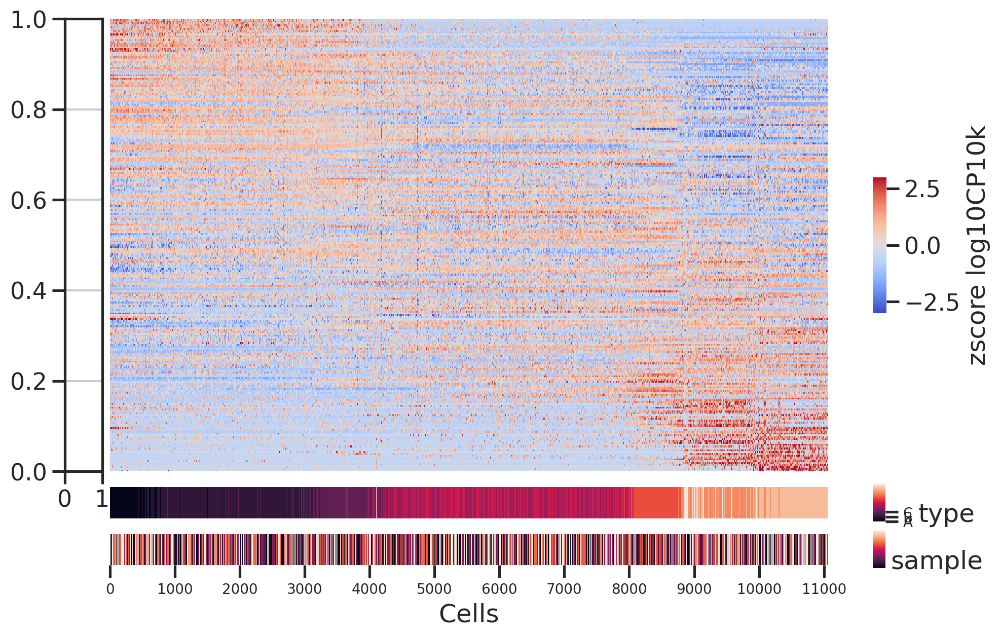

In [76]:
geneidx = gptime_idx_all
mosaic = ("B"+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")
# print(mosaic)

fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
ax = axdict['A']
sns.heatmap(zlognorm[cellidx][:,geneidx].T,
            xticklabels=False,
            yticklabels=False,
            cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
            center=0,
            vmax=3,
            vmin=-3,
            cmap='coolwarm',
            rasterized=True,
            ax=ax,
           )

# ax = axdict['B']
# sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
#             xticklabels=False,
#             yticklabels=100,
#             cmap=cmap_d1,
#             cbar=False,
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_ylabel('Genes')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

ax = axdict['C']
sns.heatmap(pd.factorize(types[cellidx], sort=True)[0].reshape(-1,1).T, 
            xticklabels=False,
            yticklabels=False,
            # cmap=cmap_d1,
            cbar_kws=dict(ticks=[0,1,2], shrink=1.2, aspect=3, label='type'),
            rasterized=True,
            ax=ax, 
           )
fig.axes[-1].set_yticklabels(['A','B','C'], fontsize=10)
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

ax = axdict['D']
sns.heatmap(pd.factorize(samps[cellidx], sort=True)[0].reshape(-1,1).T, 
            xticklabels=1000,
            yticklabels=False,
            # cmap=cmap_d2,
            cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
            rasterized=True,
            ax=ax, 
           )
ax.set_xlabel('Cells')
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

fig.subplots_adjust(hspace=0.5)
# fig.suptitle(sample)
# powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
plt.show()

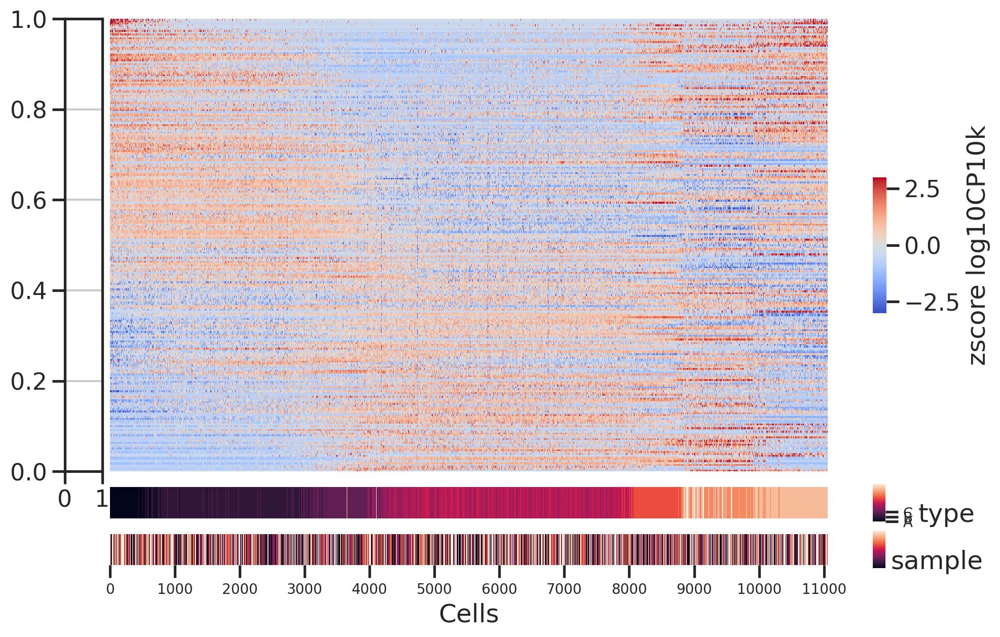

In [77]:
geneidx = gptime_idx_l23
mosaic = ("B"+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")
# print(mosaic)

fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
ax = axdict['A']
sns.heatmap(zlognorm[cellidx][:,geneidx].T,
            xticklabels=False,
            yticklabels=False,
            cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
            center=0,
            vmax=3,
            vmin=-3,
            cmap='coolwarm',
            rasterized=True,
            ax=ax,
           )

# ax = axdict['B']
# sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
#             xticklabels=False,
#             yticklabels=100,
#             cmap=cmap_d1,
#             cbar=False,
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_ylabel('Genes')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

ax = axdict['C']
sns.heatmap(pd.factorize(types[cellidx], sort=True)[0].reshape(-1,1).T, 
            xticklabels=False,
            yticklabels=False,
            # cmap=cmap_d1,
            cbar_kws=dict(ticks=[0,1,2], shrink=1.2, aspect=3, label='type'),
            rasterized=True,
            ax=ax, 
           )
fig.axes[-1].set_yticklabels(['A','B','C'], fontsize=10)
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

ax = axdict['D']
sns.heatmap(pd.factorize(samps[cellidx], sort=True)[0].reshape(-1,1).T, 
            xticklabels=1000,
            yticklabels=False,
            # cmap=cmap_d2,
            cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
            rasterized=True,
            ax=ax, 
           )
ax.set_xlabel('Cells')
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

fig.subplots_adjust(hspace=0.5)
# fig.suptitle(sample)
# powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
plt.show()

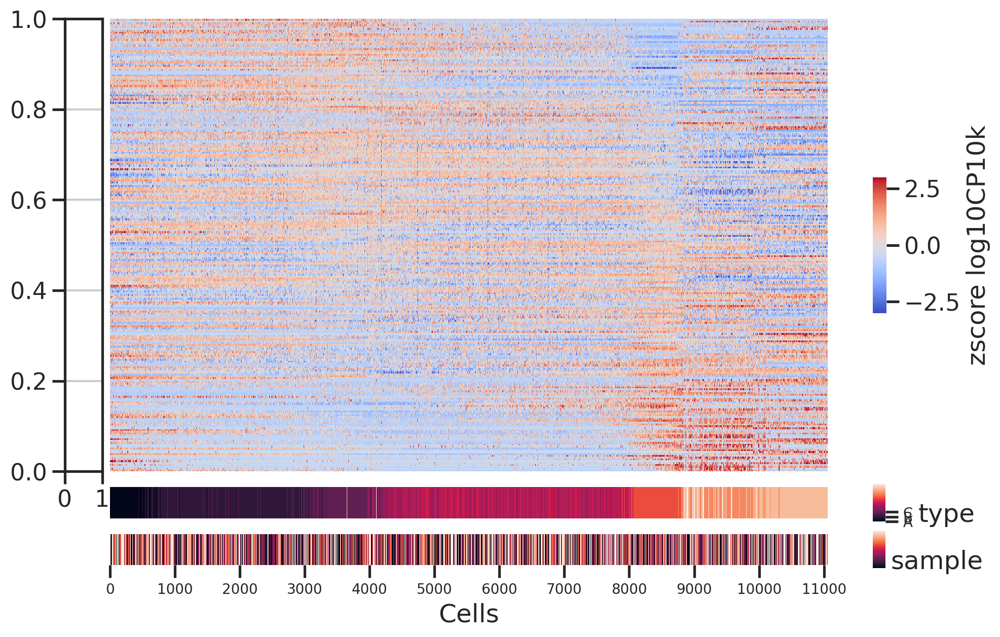

In [78]:
geneidx = gptime_idx_l4
mosaic = ("B"+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")
# print(mosaic)

fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
ax = axdict['A']
sns.heatmap(zlognorm[cellidx][:,geneidx].T,
            xticklabels=False,
            yticklabels=False,
            cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
            center=0,
            vmax=3,
            vmin=-3,
            cmap='coolwarm',
            rasterized=True,
            ax=ax,
           )

# ax = axdict['B']
# sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
#             xticklabels=False,
#             yticklabels=100,
#             cmap=cmap_d1,
#             cbar=False,
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_ylabel('Genes')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

ax = axdict['C']
sns.heatmap(pd.factorize(types[cellidx], sort=True)[0].reshape(-1,1).T, 
            xticklabels=False,
            yticklabels=False,
            # cmap=cmap_d1,
            cbar_kws=dict(ticks=[0,1,2], shrink=1.2, aspect=3, label='type'),
            rasterized=True,
            ax=ax, 
           )
fig.axes[-1].set_yticklabels(['A','B','C'], fontsize=10)
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

ax = axdict['D']
sns.heatmap(pd.factorize(samps[cellidx], sort=True)[0].reshape(-1,1).T, 
            xticklabels=1000,
            yticklabels=False,
            # cmap=cmap_d2,
            cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
            rasterized=True,
            ax=ax, 
           )
ax.set_xlabel('Cells')
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

fig.subplots_adjust(hspace=0.5)
# fig.suptitle(sample)
# powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
plt.show()

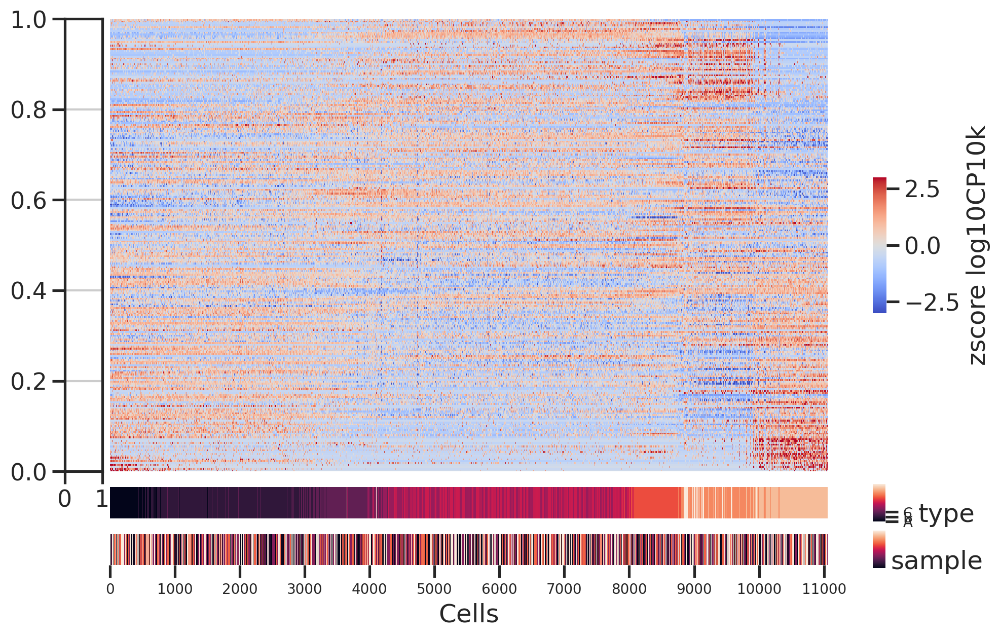

In [79]:

geneidx = gptime_idx_l56
mosaic = ("B"+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")
# print(mosaic)

fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
ax = axdict['A']
sns.heatmap(zlognorm[cellidx][:,geneidx].T,
            xticklabels=False,
            yticklabels=False,
            cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
            center=0,
            vmax=3,
            vmin=-3,
            cmap='coolwarm',
            rasterized=True,
            ax=ax,
           )

# ax = axdict['B']
# sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
#             xticklabels=False,
#             yticklabels=100,
#             cmap=cmap_d1,
#             cbar=False,
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_ylabel('Genes')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

ax = axdict['C']
sns.heatmap(pd.factorize(types[cellidx], sort=True)[0].reshape(-1,1).T, 
            xticklabels=False,
            yticklabels=False,
            # cmap=cmap_d1,
            cbar_kws=dict(ticks=[0,1,2], shrink=1.2, aspect=3, label='type'),
            rasterized=True,
            ax=ax, 
           )
fig.axes[-1].set_yticklabels(['A','B','C'], fontsize=10)
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

ax = axdict['D']
sns.heatmap(pd.factorize(samps[cellidx], sort=True)[0].reshape(-1,1).T, 
            xticklabels=1000,
            yticklabels=False,
            # cmap=cmap_d2,
            cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
            rasterized=True,
            ax=ax, 
           )
ax.set_xlabel('Cells')
fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

fig.subplots_adjust(hspace=0.5)
# fig.suptitle(sample)
# powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
plt.show()